In [1]:
%%capture
#%load_ext nb_black
#!pip install altair
import plotly.graph_objs as go
from sklearn import preprocessing
import os
import pickle
from os import path
from allensdk.core.cell_types_cache import CellTypesCache
import pandas as pd
import pickle
from input_resistance import get_gouwens, get_input_resistance, get_markram, get_traub, get_druckman
import numpy as np
# THe transformed values, ordered from highest to lowest variance dimensions
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import plotly.express as px
import plotly.graph_objects as go
from sklearn.decomposition import PCA
import plotly.io as pio
import copy
import warnings
#warnings.filter("ignore")
import pickle
import plotly
import chart_studio.plotly as py
import plotly.offline as py
py.init_notebook_mode(connected=True)
import seaborn


import matplotlib as mpl
import seaborn as sns
from IPython.display import display, Markdown, Latex
import pickle
import pandas as pd

pd.set_option("precision", 3)
from os import path

mpl.rcParams.update(mpl.rcParamsDefault)
default_font = mpl.rcParamsDefault["font.size"]
default_fig_size = mpl.rcParamsDefault["figure.figsize"]

from sklearn.preprocessing import StandardScaler

from sklearn.decomposition import PCA
from sklearn.manifold import Isomap, TSNE
#GITHUB = False
#if GITHUB:
#    pio.renderers.default = "svg"
#else:

#pio.renderers.default = 'notebook'
py.offline.init_notebook_mode(connected=True)
py.offline.init_notebook_mode(connected=True)
py.offline.plot #function works
def set_style():
    # This sets reasonable defaults for font size for
    # a figure that will go in a paper
    sns.set_context("paper")
    
    # Set the font to be serif, rather than sans
    sns.set(font='serif')
    
    # Make the background white, and specify the
    # specific font family
    sns.set_style("white", {
        "font.family": "serif",
        "font.serif": ["Times", "Palatino", "serif"]
    })
    sns.set_style("ticks", {"xtick.major.size": 8, "ytick.major.size": 8})
    sns.despine()


set_style()    


In [2]:
ctc = CellTypesCache(manifest_file="cell_types/manifest.json")
all_cells = ctc.get_ephys_features()
cells = ctc.get_cells()
indexs_allen = pd.Series(
    [
        cell["id"]
        for cell, a in zip(cells, all_cells)
        if cell["species"] != "Homo Sapiens"
    ]
)
df_allen = pd.DataFrame()
res_allen = pd.Series(
    [
        a["input_resistance_mohm"]
        for cell, a in zip(cells, all_cells)
        if cell["species"] != "Homo Sapiens"
    ]
)
df_allen["input_resistance"] = res_allen
df_allen["allen_id"] = indexs_allen

df_allen.index = indexs_allen
df_allen;

In [3]:
import os.path as path

if not os.path.exists("osf_data"):
    try:
        !wget wget --max-redirect=20 -O osf_data.zip https://www.dropbox.com/sh/ywxerwcmly7rtfi/AACt8Q6pIkNj1ABR9AVzLu64a?dl=1
    except:
        !curl -L https://www.dropbox.com/sh/ywxerwcmly7rtfi/AACt8Q6pIkNj1ABR9AVzLu64a?dl=1 > osf_data.zip
    !unzip osf_data.zip

if path.exists("osf_data/onefive_df.pkl"):
    df = pickle.load(open("osf_data/onefive_df.pkl", "rb"))

if path.exists("osf_data/dm_on_models.p"):
    with open("osf_data/dm_on_models.p", "rb") as f:
        contents = pickle.load(f)

if path.exists("osf_data/hbp_data.p"):
    hbp = pickle.load(open("osf_data/hbp_data.p", "rb"))

if path.exists("osf_data/optimized_multi_feature.p"):
    useable = pickle.load(open("osf_data/optimized_multi_feature.p", "rb"))


with open("osf_data/dm_on_models.pkl", "rb") as f:
    (IZHI_dtc, ADEXP_dtc) = pickle.load(f)

with open("osf_data/redundancy_removed.p", "rb") as f:
    removed = pickle.load(f)

with open("osf_data/gouwens.p", "rb") as f:
    gouwens = pickle.load(f)

with open("osf_data/markram.pkl", "rb") as f:
    markram = pickle.load(f)


with open("osf_data/traub.p", "rb") as f:
    traub = pickle.load(f)

hbp = pickle.load(open("hbp_data3.p", "rb"))


with open("osf_data/redundancy_removed.p", "rb") as f:
    removed = pickle.load(f)


with open("nml_frame.p", "rb") as f:
    _, membership = pickle.load(f)    
    
df.drop_duplicates(inplace=True, keep=False)


In [4]:
def data_frame_preprocess(x):
    try:
        return np.mean(x)
    except:
        try:
            return np.mean(x["pred"])
        except:
            return np.mean(x["mean"])


df = df.applymap(data_frame_preprocess)


def mutate_frame_columns(df_everything, modifyer):
    """
    Adjust data frame column names so they fit into a universal scheme.
    """
    for c in df_everything.columns:
        if str(c) + str("_1.5x") in modifyer.columns:
            df_everything[str(c) + str("_1.5x")] = df_everything[c]
        if str(c) + str("_3.0x") in modifyer.columns:
            df_everything[str(c) + str("_3.0x")] = df_everything[c]
    temp = df_everything
    for c in df_everything.columns:
        if str("_1.5x") not in str(c) and str("_3.0x") not in str(
            c
        ):  # in df_everything.columns:
            temp = temp.drop(columns=[c])
        # if str(c)+str('_3.0x') in df_everything.columns:
        #    df_everything[str(c)+str('_1.5x')] = df_everything[c]
    df_everything = temp
    return df_everything

In [5]:
df_resistance = pickle.load(open("one_five_resistances.p", "rb"))
for ind in df.index:
    try:
        df.loc[ind, "input_resistance"] = df_resistance.loc[ind, "input_resistance"]
    except:
        pass
df = df[~df.index.duplicated()]
df.drop_duplicates(inplace=True, keep=False)
#df = df.drop_duplicates()





In [6]:
bbp_frame = pd.DataFrame([i.everything for i in hbp if i != None and hasattr(i,'everything')])
#bbp_frame.drop_duplicates(inplace=True)
bbp_frame = bbp_frame[~bbp_frame.index.duplicated()]
#bbp_frame.drop_duplicates(inplace=True, keep=False)
names = [i.name for i in hbp if i != None and hasattr(i,'everything')]
bbp_frame.index = names
bbp_frame = mutate_frame_columns(bbp_frame,df)

bbp_frame.fillna(value=pd.np.nan).dropna(axis=0, thresh=10,inplace=True)
bbp_frame.fillna(0,inplace=True)
bbp_frame = bbp_frame.applymap(data_frame_preprocess)

bbp_frame.shape;
stable_list = list(bbp_frame.index.values)

df = pd.concat([df,bbp_frame])
stable_list;

In [7]:
df = df.fillna(value=pd.np.nan).dropna(axis=0, thresh=10)
df = df.fillna(value=pd.np.nan).dropna(axis=1, thresh=10)

df.shape;

In [8]:
#assert 1==2
'''
bbp_frame = pd.DataFrame([i.everything for i in hbp if i != None and hasattr(i,'everything')])
#bbp_frame.drop_duplicates(inplace=True)
bbp_frame = bbp_frame[~bbp_frame.index.duplicated()]
#bbp_frame.drop_duplicates(inplace=True, keep=False)
names = [i.name for i in hbp if i != None and hasattr(i,'everything')]
bbp_frame.index = names
bbp_frame = mutate_frame_columns(bbp_frame,df)
bbp_frame.fillna(value=pd.np.nan, inplace=True)
#bbp_frame.fillna(None,inplace=True)
#bbp_frame = 
bbp_frame = bbp_frame.dropna(axis='rows')#,inplace= True)

print(len(bbp_frame))
new_ = []
for i,j in zip(bbp_frame.index,bbp_frame.isnull().sum(axis=1).tolist()):
    #print(j)
    if j>100:
        new_.append(i)
bbp_frame.drop(new_,inplace=True)
bbp_frame = bbp_frame.applymap(data_frame_preprocess)
'''

"\nbbp_frame = pd.DataFrame([i.everything for i in hbp if i != None and hasattr(i,'everything')])\n#bbp_frame.drop_duplicates(inplace=True)\nbbp_frame = bbp_frame[~bbp_frame.index.duplicated()]\n#bbp_frame.drop_duplicates(inplace=True, keep=False)\nnames = [i.name for i in hbp if i != None and hasattr(i,'everything')]\nbbp_frame.index = names\nbbp_frame = mutate_frame_columns(bbp_frame,df)\nbbp_frame.fillna(value=pd.np.nan, inplace=True)\n#bbp_frame.fillna(None,inplace=True)\n#bbp_frame = \nbbp_frame = bbp_frame.dropna(axis='rows')#,inplace= True)\n\nprint(len(bbp_frame))\nnew_ = []\nfor i,j in zip(bbp_frame.index,bbp_frame.isnull().sum(axis=1).tolist()):\n    #print(j)\n    if j>100:\n        new_.append(i)\nbbp_frame.drop(new_,inplace=True)\nbbp_frame = bbp_frame.applymap(data_frame_preprocess)\n"

In [9]:
new_ = []
for i,j in zip(df.index,df.isnull().sum(axis=1).tolist()):
    if j>100:
        new_.append(i)
df.drop(new_,inplace=True)

In [10]:
del df["InputResistanceTest_1.5x"]
del df["InputResistanceTest_3.0x"]
del df["ohmic_input_resistance_3.0x"]
del df["ohmic_input_resistance_1.5x"]

In [11]:
def remove_reduncy(df, removed):

    for c in removed.columns:

        if c in df.columns:
            del df[c]
            print(c)
    return df

for c in removed.columns:
    df.drop(c, axis=1, inplace=True)
removed.columns[0]
try:
    del df["ohmic_input_resistance_vb_ssse_3.0x"]
except:
    pass

In [12]:
df = df[~df.index.duplicated()]
#df = df.drop_duplicates()
#expriment_df.drop(528638213, inplace=True)
import requests
import json
def get_static_models(cell_id):
    url = str("https://neuroml-db.org/api/model?id=")+cell_id
    model_contents = requests.get(url)
    model_contents = json.loads(model_contents.text)
    return (model_contents['model']['Name'],model_contents['publication']['record']['Full_Title'],cell_id)
          


In [13]:
# Change so that prefix NLMC is models and everything else is data


#expriment_df.drop(528638213, inplace=True)
#expriment_df.drop(584561230, inplace=True)
#expriment_df.drop(509683388, inplace=True)


experiment_idx = [idx for idx in df.index.values if type(idx) == int]
experiment_df = df[df.index.isin(experiment_idx)]
experiment_df = experiment_df.drop_duplicates(keep=False)
experiment_df.drop_duplicates(inplace=True, keep=False)
exp = df.loc[set(experiment_df.index.values), :]
temp = set(experiment_df.index.values)
nan_list = df.columns[df.isna().any()].tolist()
nan_list;
df['AccommodationRateToSSTest_3.0x'];

In [14]:

model_idx = [idx for idx in df.index.values if str("NML") in str(idx)]
model_df = df[df.index.isin(model_idx)]


# make experiment dataframe
experiment_idx = [idx for idx in df.index.values if type(idx) == int]
experiment_no_trans_df = df[df.index.isin(experiment_idx)]
experiment_df = experiment_no_trans_df.copy()


# model_df2
# model_no_trans_df2
experiment_df = pd.DataFrame.drop_duplicates(experiment_df)
experiment_df.groupby(experiment_df.index).first()
len(experiment_df);


In [15]:
df;

In [16]:
get = False
if get:
    pubs = []
    for cell_id in model_df.index:
        try:
            pubs.append(get_static_models(cell_id))
            pickle.dump(pubs,open('dropped_cortical2.p','wb'))
        except:
            pass


In [17]:


pubs = pickle.load(open('dropped_cortical2.p','rb'))
pubs_df = pd.DataFrame(columns=["Cell Name","Publication"])
pubs_df["Cell ID"] = pd.Series([i[2] for i in pubs])
pubs_df["Publication"] = pd.Series([i[1] for i in pubs])
pubs_df["Cell Name"] = pd.Series([i[0] for i in pubs])
pubs_df.index =  pd.Series([i[2] for i in pubs])

display(Markdown(str(len(pubs_df))))    
#pubs_df.iloc[10:100]#pubs



281

In [18]:
pubs[0]

model_to_drop = ["NMLCL001542","NMLCL000641","NMLCL001123","NMLCL001657","NMLCL001530","NMLCL001660","NMLCL001434"]
df.drop(model_to_drop, inplace=True)
df.drop(528638213, inplace=True)
df.drop(584561230, inplace=True)
df.drop(509683388, inplace=True)


In [19]:
if False:
    gouwens_pub = []
    for id_ in df[df.index.isin(gwindex)].index.values:
        gouwens_pub.append(get_static_models(id_))
    gouwens_pub_df = pd.DataFrame(columns=["Cell Name","Publication"])
    gouwens_pub_df["Cell ID"] = pd.Series([i[2] for i in gouwens_pub])
    gouwens_pub_df["Publication"] = pd.Series([i[1] for i in gouwens_pub])
    gouwens_pub_df["Cell Name"] = pd.Series([i[0] for i in gouwens_pub])
    gouwens_pub_df.index =  pd.Series([i[2] for i in gouwens_pub])

    pubs_df = pd.concat([gouwens_pub_df,pubs_df])
    pubs_df

    

In [20]:
left_out_pub = pickle.load(open('left_out_pub.p','rb'))

In [21]:

if False:
    left_out_pub = []
    for id_ in model_df[~model_df.index.isin(pubs_df.index.values)].index.values:
        if id_!='MLCL000596':
            try:
                left_out_pub.append(get_static_models(id_))
            except:
                print(id_)
                left_out_pub.append((None,None,None))
                
    pickle.dump(left_out_pub,open('left_out_pub.p','wb'))
    left_out_pub_df = pd.DataFrame(columns=["Cell Name","Publication"])
    left_out_pub_df["Cell ID"] = pd.Series([i[2] for i in left_out_pub])
    left_out_pub_df["Publication"] = pd.Series([i[1] for i in left_out_pub])
    left_out_pub_df["Cell Name"] = pd.Series([i[0] for i in left_out_pub])
    left_out_pub_df.index =  pd.Series([i[2] for i in left_out_pub])
    left_out_pub_df

    pubs_df = pd.concat([left_out_pub_df,pubs_df])
    pubs_df.drop_duplicates(inplace=True, keep=False)            

In [22]:
left_out_pub_df = pd.DataFrame(columns=["Cell Name","Publication"])
left_out_pub_df["Cell ID"] = pd.Series([i[2] for i in left_out_pub])
left_out_pub_df["Publication"] = pd.Series([i[1] for i in left_out_pub])
left_out_pub_df["Cell Name"] = pd.Series([i[0] for i in left_out_pub])
left_out_pub_df.index =  pd.Series([i[2] for i in left_out_pub])
left_out_pub_df

pubs_df = pd.concat([left_out_pub_df,pubs_df])
pubs_df.drop_duplicates(inplace=True, keep=False)    

In [23]:
set(pubs_df["Publication"]);

In [24]:
#pubs_df = pickle.load(open('pubs_df.p','rb'))

subset0 = pubs_df[pubs_df["Publication"]=='Generalized leaky integrate-and-fire models classify multiple neuron types.']
subset1 = pubs_df[pubs_df["Publication"]=='Dendritic spikes enhance stimulus selectivity in cortical neurons in vivo.']
subset2 = pubs_df[pubs_df["Publication"]=='Minimal Hodgkin-Huxley type models for different classes of cortical and thalamic neurons.']
subset3 = pubs_df[pubs_df["Publication"]=='Single-column thalamocortical network model exhibiting gamma oscillations, sleep spindles, and epileptogenic bursts']


In [25]:
set(pubs_df["Publication"])

{'Dendritic spikes enhance stimulus selectivity in cortical neurons in vivo.',
 'Generalized leaky integrate-and-fire models classify multiple neuron types.',
 'Minimal Hodgkin-Huxley type models for different classes of cortical and thalamic neurons.',
 'Models of Neocortical Layer 5b Pyramidal Cells Capturing a Wide Range of Dendritic and Perisomatic Active Properties',
 'Reconstruction and Simulation of Neocortical Microcircuitry.',
 'Single-column thalamocortical network model exhibiting gamma oscillations, sleep spindles, and epileptogenic bursts',
 'Systematic generation of biophysically detailed models for diverse cortical neuron types.'}

In [26]:

df.drop(subset0.index, inplace=True)
df.drop(subset1.index, inplace=True)
df.drop(subset2.index, inplace=True)
df.drop(subset3.index, inplace=True)

print(len(df), 'b4')
# Drop blue brain models and data

ALLEN_ONLY = True
BBP_ONLY = False
if ALLEN_ONLY:
    subset4 = pubs_df[pubs_df["Publication"]=='Reconstruction and Simulation of Neocortical Microcircuitry.']
    df.drop(subset4.index, inplace=True)
    df.drop(stable_list, inplace=True)
    print(len(df), 'after')
if BBP_ONLY:
    subset5 = pubs_df[pubs_df["Publication"]=='Systematic generation of biophysically detailed models for diverse cortical neuron types.']
    df.drop(subset5.index, inplace=True)
    
    experiment_idx_pre_labels = [
    idx for i, idx in enumerate(df.index.values) if type(idx) == int
    ]
    df.drop(experiment_idx_pre_labels, inplace=True)

1278 b4
388 after


In [27]:


cell_feature_zero = {}
for feature in df.columns:  # .items()):
    for j in df.index.values:
        if df.loc[j, feature] == 0:
            if j not in cell_feature_zero.keys():
                cell_feature_zero[j] = []
                cell_feature_zero[j].append(feature)
            else:
                cell_feature_zero[j].append(feature)
remove_dict = {}
for k,v in cell_feature_zero.items():
    if len(v)>=9:
        remove_dict[k] = v
        #print(k,len(v))

print(len(df),'b4')
for k in remove_dict.keys():
    df.drop(k,inplace=True)
print(len(df),'after')

388 b4
275 after


In [28]:
#pubs_df[pubs_df["Publication"]=='Generalized leaky integrate-and-fire models classify multiple neuron types.'];

In [29]:
gwn_check = list(gouwens.values())
gwindex = gwn_check[0][0]
gouwens_idx = [idx for idx in df.index.values if idx in gwindex]
gouwens_idx_labels = [i for i in gouwens_idx]
gouwens_idx_labels = df.index.isin(gouwens_idx)
gouwens_cells = df[df.index.isin(gouwens_idx)]
unusual = df[df.index.isin(gouwens_idx)]
gouwens_cells;



    
markram_check = list(markram.values())
markramindex = markram_check[0][0]
markram_idx = [idx for idx in df.index.values if idx in markramindex]
markram_idx_labels = [i for i in markram_idx]
markram_idx_labels = df.index.isin(markram_idx)
markram_cells = df[df.index.isin(markram_idx)]

markram_cells;
experiment_idx = [idx for idx in df.index.values if type(idx)==int]
#experiment_idx_pre_labels = [i for i,idx in enumerate(df.index.values) if type(idx)==int]

experiment_idx_pre_labels = [
    idx for i, idx in enumerate(df.index.values) if type(idx) == int
]

if 'stable_list' in locals():
    experiment_idx_pre_labels.extend(stable_list)
    bbp_labels = df.index.isin(stable_list)
experiment_idx = experiment_idx_pre_labels
experiment_idx_labels = df.index.isin(experiment_idx_pre_labels)


#experiment_idx_labels = [i[0] for i in experiment_idx_labels]
experiment_idx_labels
model_index_labels = ~df.index.isin(experiment_idx)

model_index_labels;
model_index_labels = df.index.isin(model_idx);
gwn_check = list(gouwens.values())
gwindex = gwn_check[0][0]
gouwens_idx = [idx for idx in df.index.values if idx in gwindex]
gouwens_idx_labels = [i for i in gouwens_idx]
gouwens_idx_labels = df.index.isin(gouwens_idx)
gouwens_cells = df[df.index.isin(gouwens_idx)]
unusual = df[df.index.isin(gouwens_idx)]
gouwens_cells;



    
markram_check = list(markram.values())
markramindex = markram_check[0][0]
markram_idx = [idx for idx in df.index.values if idx in markramindex]
markram_idx_labels = [i for i in markram_idx]
markram_idx_labels = df.index.isin(markram_idx)
markram_cells = df[df.index.isin(markram_idx)]

markram_cells;
experiment_idx = [idx for idx in df.index.values if type(idx)==int]
model_no_trans_df = df[~df.index.isin(experiment_idx)]
#experiment_idx_pre_labels = [i for i,idx in enumerate(df.index.values) if type(idx)==int]

experiment_idx_pre_labels = [
    idx for i, idx in enumerate(df.index.values) if type(idx) == int
]

if 'stable_list' in locals():
    experiment_idx_pre_labels.extend(stable_list)
    bbp_labels = df.index.isin(stable_list)
experiment_idx = experiment_idx_pre_labels
experiment_idx_labels = df.index.isin(experiment_idx_pre_labels)
experiment_idx_labels
model_index_labels = ~df.index.isin(experiment_idx)
model_index_labels;
model_index_labels = df.index.isin(model_idx);


In [30]:
gwn_check = list(gouwens.values())
gwindex = gwn_check[0][0]
gouwens_idx = [idx for idx in df.index.values if idx in gwindex]
gouwens_idx_labels = [i for i in gouwens_idx]
gouwens_idx_labels = df.index.isin(gouwens_idx)
gouwens_cells = df[df.index.isin(gouwens_idx)]
unusual = df[df.index.isin(gouwens_idx)]
gouwens_cells;



    
markram_check = list(markram.values())
markramindex = markram_check[0][0]
markram_idx = [idx for idx in df.index.values if idx in markramindex]
markram_idx_labels = [i for i in markram_idx]
markram_idx_labels = df.index.isin(markram_idx)
markram_cells = df[df.index.isin(markram_idx)]

markram_cells;
experiment_idx = [idx for idx in df.index.values if type(idx)==int]
model_no_trans_df = df[~df.index.isin(experiment_idx)]
#experiment_idx_pre_labels = [i for i,idx in enumerate(df.index.values) if type(idx)==int]

experiment_idx_pre_labels = [
    idx for i, idx in enumerate(df.index.values) if type(idx) == int
]

if 'stable_list' in locals():
    experiment_idx_pre_labels.extend(stable_list)
    bbp_labels = df.index.isin(stable_list)
experiment_idx = experiment_idx_pre_labels
experiment_idx_labels = df.index.isin(experiment_idx_pre_labels)

model_no_trans_df


#experiment_idx_labels = [i[0] for i in experiment_idx_labels]
experiment_idx_labels
model_no_trans_df
model_index_labels = ~df.index.isin(experiment_idx)

model_index_labels;
model_index_labels = df.index.isin(model_idx);


In [31]:
stable_list;

In [32]:
traub_check = list(traub.values())
traubindex = traub_check[0][0]

traub_idx = [idx for idx in df.index.values if idx in traubindex]
traub_idx_labels = df.index.isin(traub_idx)
traub_cells = df[df.index.isin(traub_idx)]
traub_cells


# make model dataframe
model_idx = [idx for idx in df.index.values if str("NML") in str(idx)]
#try:
model_idx = [m for m in model_idx if m not in set(stable_list)]
#except:
#    pass
model_idx = set(model_idx)
model_df = df[df.index.isin(model_idx)]
#model_no_trans_df.index.name = "Cell_ID"
#model_df = model_no_trans_df.copy()
#model_df.index.name = "Cell_ID"
#model_df[model_df.index.isin(subset.index)]
# make experiment dataframe
experiment_idx = [idx for idx in df.index.values if type(idx) == int]
try:
    experiment_idx.extend(stable_list)
except:
    pass
experiment_no_trans_df = df[df.index.isin(experiment_idx)]
experiment_df = experiment_no_trans_df.copy()
experiment_df;



In [33]:
experiment_df.index;
#part0 = df.index.isin(subset.index.values)
#part1 = df.index.isin(experiment_df.index)

In [34]:
experiment_idx_labels = df.index.isin(experiment_idx_pre_labels)


In [35]:




unscaled = copy.copy(df)
unscaled.dropna(axis=0, how='any', thresh=3, inplace=True)


In [36]:

import numpy as np
from sklearn.impute import SimpleImputer
import numpy as np
import copy
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
if True:

    imp = IterativeImputer(max_iter=10, random_state=0)
    imp.fit(df)
    IterativeImputer(random_state=0)
    # X_test = [[np.nan, 2], [6, np.nan], [np.nan, 6]]
    # the model learns that the second feature is double the first
    dfimp = imp.transform(df)

if True:

    imp = SimpleImputer(missing_values=np.nan, strategy="mean")
    imp.fit(df)
    SimpleImputer()

    df.values[:] = imp.transform(df.values[:])
df.shape

NORMALIZED_PCA = True
if NORMALIZED_PCA:
    ss = StandardScaler()
    ss.fit_transform(df.values[:])
    df.values[:] = ss.transform(df.values[:])

In [37]:
isomap = Isomap(n_components=2)
isomap.fit(copy.copy(df.values))
iso = isomap.embedding_.T
n_features = df.shape[1]



#PCA(n_components=2)


In [38]:
# ("Set1", n_colors=8, desat=.5
# colors = sns.color_palette(palette=sns.palplot(sns.color_palette()), n_colors=10)#, desat=None)
# colors[0]
#pallete =
#colors = sns.color_palette(palette= sns.palplot(sns.color_palette("Set1", n_colors=10, desat=0.999)), n_colors=10);#, desat=None)



In [39]:
model_idx;

In [40]:
# https://stackoverflow.com/questions/17553035/draw-a-smooth-polygon-around-data-points-in-a-scatter-plot-in-matplotlib
#Taken from http://wiki.scipy.org/Cookbook/Finding_Convex_Hull

cmap1 = sns.cubehelix_palette(dark=.3, light=.8, as_cmap=True)
cmap1.colors;

<Figure size 432x288 with 0 Axes>

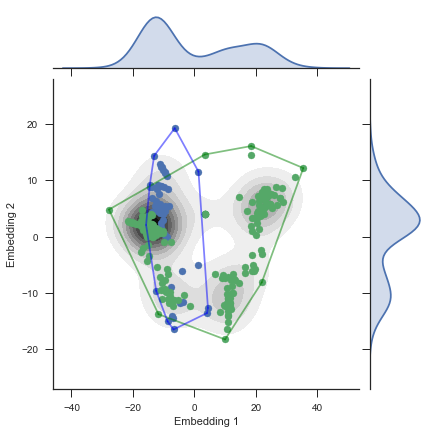

In [41]:
from scipy.spatial import ConvexHull, convex_hull_plot_2d
points1 = np.array(iso[:, experiment_idx_labels]).T   # 30 random points in 2-D
hull1 = ConvexHull(points1)

import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d


points0 = np.array(iso[:, model_index_labels]).T   # 30 random points in 2-D
hull0 = ConvexHull(points0)

set_style()    
ax = sns.jointplot(x=iso[0,:], y=iso[1,:],kind="kde",cmap='Greys')
#ax.set(xlabel='Embedding 1', ylabel='Embedding 2', title='TSNE Dim Reduction')

cmaps = ['Blues','Purples']
cola = cmaps.pop()
ax.ax_joint.scatter(points0[:,0],points0[:,1], cmap='b',label = 'Experiment')#,alpha=0.5)
colb = cmaps.pop()

ax.ax_joint.scatter(points1[:,0],points1[:,1], cmap='r',label = 'Model')#,alpha=0.5)


xs = []
for simplex in hull1.simplices:
    ax.ax_joint.plot(points1[simplex, 0], points1[simplex, 1], 'g-',alpha=0.5)
    xs.append((points1[simplex, 0], points1[simplex, 1]))

for simplex in hull0.simplices:
    ax.ax_joint.plot(points0[simplex, 0], points0[simplex, 1], 'b-',alpha=0.5)    

ax.ax_joint.collections[0].set_alpha(0)
ax.ax_joint.legend_.remove()
ax.ax_joint.set(xlabel='Embedding 1', ylabel='Embedding 2')#, title='TSNE Dim Reduction')



plt.legend()
plt.show()

In [42]:
model_idx
#cell_names = pubs_df.loc[:,'Cell Name']
pubs_df['Cell Name'].values
experiment_idx

pubs_df = pubs_df[pubs_df.index.isin(model_df.index)]
model_names = list(pubs_df['Cell Name'].values)
model_names;

#print(len(model_names),len(model_df))
model_df.drop_duplicates(inplace=True)
#print(len(model_df))
model_names = []
for i in zip(model_df.index.values):
    try:
        model_names.append(str(pubs_df.loc[i]['Cell Name']))
    except:
        model_names.append(None)
model_names;

In [43]:
# plot([Scatter(x=[1, 2, 3], y=[3, 1, 6])], config=UNBRAND_CONFIG)

data = []
trace0 = (
    iso[0, experiment_idx_labels],
    iso[1, experiment_idx_labels],
    "All Experiment",
    experiment_idx,
)
trace1 = (
    iso[0, model_index_labels],
    iso[1, model_index_labels],
    "All Cortical Models",
    model_names,
)    
    
#    "All Cortical Models",
#    model_names,
#)

trace3 = (
    iso[0, gouwens_idx_labels],
    iso[1, gouwens_idx_labels],
    "Gouwen Models",
    gouwens_idx,
)
trace4 = (
    iso[0, markram_idx_labels],
    iso[1, markram_idx_labels],
    "Markram Models",
    markram_idx,
)



trace5 = (
    iso[0, traub_idx_labels],
    iso[1, traub_idx_labels],
    "Traub Models",
    traub_idx_labels,
)



    

#for simplex in hull1.simplices:
#    plt.plot(points1[simplex, 0], points1[simplex, 1], 'b-')
    





if "bbp_labels" not in locals():
    traces = [trace0, trace1, trace3, trace4, trace5]

else:
    trace2 = (
        iso[0, bbp_labels],
        iso[1, bbp_labels],
        "BBP Experiment",
        stable_list,
    )

    traces = [trace0, trace1]#, trace2, trace3, trace4, trace5]


cnt = 0
theme = px.colors.diverging.Portland

for i, ttt in enumerate(traces):
    if cnt == len(theme):
        cnt = 0
    if i > 1:
        size = 6
    else:
        size = 6
        # if type(ttt[3]) is not type(str()):

    trace = dict(
        type="scatter",
        text=df[df.index.isin(ttt[3])].index,
        x=ttt[0],
        y=ttt[1],
        mode="markers",
        name=ttt[2],
        marker=dict(
            color=theme[cnt],
            size=size,
            line=dict(color="rgba(217, 217, 217, 0.14)", width=0.5),
            opacity=0.8,
        ),
    )
    data.append(trace)
    cnt += 1

  
  
fig = go.Figure(data=data, layout_title_text="TSNE Dimensionality Reduction")  # ,


fig.update_layout(
    autosize=False,
    plot_bgcolor="rgba(0,0,0,0)",
    xaxis={"showgrid": False, "zeroline": False},
    yaxis={"showgrid": False, "zeroline": False},
    width=1000,
    height=800,
    font_size=22,
)
fig.update_traces(
    marker=dict(size=7, line=dict(width=0.5, color="DarkSlateGrey")),
    selector=dict(mode="markers"),
    opacity=0.9,
)

fig.show()


In [44]:
df[gouwens_idx_labels];

In [45]:
#hull1.simplices

In [46]:
from sklearn.multiclass import OneVsRestClassifier
from sklearn.svm import SVC
py.offline.init_notebook_mode(connected=True)
py.offline.init_notebook_mode(connected=True)
py.offline.plot #function works
data = []
trace0 = (
    iso[0, experiment_idx_labels],
    iso[1, experiment_idx_labels],
    "Allen Inst. Experiment",
    experiment_idx,
)
trace1 = (
    iso[0, model_index_labels],
    iso[1, model_index_labels],
    "All Cortical Models",
    model_idx,
)


traces = [
    trace0,
    trace1,
    
    None,
]  # , trace5, trace6, None]  # trace7, None]


if "bbp_labels" not in locals():
    traces = [trace0, trace1, None]

else:
    trace2 = (
        iso[0, bbp_labels],
        iso[1, bbp_labels],
        "BBP Experiment",
        stable_list,
    )
    traces = [trace0, trace1, None]#trace2, trace3, trace4, None]
groundtruth = np.array(df.index.isin(experiment_idx))


classif = OneVsRestClassifier(SVC(kernel="linear"))
classif.fit(iso.T, groundtruth)
min_x = np.min(iso[0, :])
max_x = np.max(iso[0, :])
w = classif.coef_[0]
a = -w[0] / w[1]
xx = np.linspace(min_x, max_x)  # make sure the line is long enough
yy = a * xx - (classif.intercept_[0]) / w[1]


cnt = 0

used_columns = df.columns
pal = sns.husl_palette(8, s=0.45)
lut = dict(zip(map(str, used_columns), pal))
colors = pd.Series(used_columns, index=df.columns).map(lut)
theme = px.colors.diverging.Portland
theme.extend(colors[15:-1])
for i, ttt in enumerate(traces):
    # if cnt==len(theme):
    #    cnt=0
    size = 6
    if i > 1:
        pass
        # size = 12
    else:
        size = 6
        text = df[df.index.isin(ttt[3])].index

    if ttt == None:
        trace = {
            "line": {
                "dash": "solid",
                "color": "rgb(0,0,0)",
                "shape": "linear",
                "width": 2,
            },
            "mode": "lines",
            "name": "Decision Boundary",
            "text": "Decision Boundary",
            "type": "scatter",
            "x": xx,
            "y": yy,
            "yaxis": "y1",
            "showlegend": False,
        }
    else:
        trace = dict(
            type="scatter",
            text=text,
            x=ttt[0],
            y=ttt[1],
            mode="markers",
            name=ttt[2],
            marker=dict(
                color=theme[cnt],
                size=size,
                line=dict(color="rgba(217, 217, 217, 0.14)", width=0.5),
                opacity=0.8,
            ),
        )
    cnt += 1
    data.append(trace)


fig = go.Figure(
    data=data, layout_title_text="Dimensionality Reduction"
)  # , marginal="histogram"
# )  # ,

# mode='markers', marker_size=18,
fig.update_layout(
    plot_bgcolor="rgba(0,0,0,0)",
    autosize=False,
    xaxis={"showgrid": False, "zeroline": False},
    yaxis={"showgrid": False, "zeroline": False},
    width=1050,
    height=800,
    font_size=19,
)
fig.update_traces(
    marker=dict(size=7, line=dict(width=0.5, color="DarkSlateGrey")),
    selector=dict(mode="markers"),
    opacity=0.9,
)


fig.show()

In [47]:
from sciunit.scores import CohenDScore

feature_scores = []
for i, feature in enumerate(unscaled.columns):  # .items()):

    observation = {
        "mean": np.mean(unscaled.loc[experiment_idx_labels, feature]),
        "std": np.std(unscaled.loc[model_index_labels, feature]),
    }
    prediction = {
        "mean": np.mean(unscaled.loc[model_index_labels, feature]),
        "std": np.std(unscaled.loc[model_index_labels, feature]),
    }
    score = CohenDScore.compute(observation, prediction)
    feature_scores.append((feature, score))
delete = sorted(feature_scores, key=lambda x: x[1])
delete = delete
dd = {k:v for k,v in delete}


In [48]:
df_models = df[~df.index.isin(experiment_idx)]
df_data = df[df.index.isin(experiment_idx)]
df_combined = pd.concat([df_data, df_models])
groundtruth = np.array(df.index.isin(experiment_idx))
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
lda = LDA(solver='lsqr', shrinkage='auto')
lda.fit(df_combined.values, groundtruth);

In [49]:
lda_to_drop = pd.Series(np.abs(lda.coef_[0]), index=df_combined.columns).sort_values(ascending=False)#[0:39]

In [50]:

from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor


df_models = df[~df.index.isin(experiment_idx)]
df_data = df[df.index.isin(experiment_idx)]

df_combined = pd.concat([df_data, df_models])

groundtruth = np.array(df.index.isin(experiment_idx))
rfc = RandomForestClassifier()
X = df_combined.values
rfc.fit(X, groundtruth)

importances = pd.Series(index=df_combined.columns, data=rfc.feature_importances_)

feature_variance = importances.sort_values(ascending=False)[0:40]
total_list = importances.sort_values(ascending=False)
tll = {k: v for k, v in zip(total_list.index, total_list)}
deletel = [d[0] for d in delete]
combined_weight = {}
for k in tll.keys():
    cw = np.abs(float(dd[k].raw))#) / 2.0
    combined_weight[k] = cw

combined_weight = [(k, v) for k, v in combined_weight.items()]

combined_weight = sorted(combined_weight, key=lambda x: x[1], reverse=False)
combined_weight;

feature_variance.index
feature_variance = feature_variance.index


In [51]:
lda_to_drop.index;

In [52]:
before_delete = copy.copy(df)
# for col in feature_variance:

for col in combined_weight[0:10]:#delete[0:40]:
#for col in lda_to_drop.index[0:10]:
    del df[col[0]]
isomap = Isomap(n_components=2)
isomap.fit(copy.copy(df.values))
iso = isomap.embedding_.T
n_features = df.shape[1]
feature_agree = df.columns

# del

In [53]:
numb_delete = len(before_delete.columns) - len(df.columns)

In [54]:
data = []
trace0 = (
    iso[0, experiment_idx_labels],
    iso[1, experiment_idx_labels],
    "Allen Inst. Experiments",
    experiment_idx,
)
trace1 = (iso[0, model_index_labels], iso[1, model_index_labels], "Allen Inst. Models", model_idx)
'''
trace3 = (
    iso[0, gouwens_idx_labels],
    iso[1, gouwens_idx_labels],
    "Gouwen models",
    gouwens_idx,
)
trace4 = (
    iso[0, markram_idx_labels],
    iso[1, markram_idx_labels],
    "Markram models",
    markram_idx,
)
'''

trace8 = (iso[0, traub_idx_labels], iso[1, traub_idx_labels], "Traub", traub_idx_labels)

# plt.scatter(iso[0,bbp_labels],iso[1,bbp_labels],s=10, c='purple',cmap='rainbow',label='BBP')

traces = [trace0, trace1]#, trace3, trace4]#, trace5, trace6]  # , trace7]  # ,trace8]
cnt = 0
theme = px.colors.diverging.Portland

for i, ttt in enumerate(traces):
    if cnt == len(theme):
        cnt = 0
    if i > 1:
        size = 6
    else:
        size = 6
        # if type(ttt[3]) is not type(str()):

    trace = dict(
        type="scatter",
        text=df[df.index.isin(ttt[3])].index,
        x=ttt[0],
        y=ttt[1],
        mode="markers",
        opacity=0.8,
        name=ttt[2],
        marker=dict(
            color=theme[cnt],
            size=size,
            line=dict(color="rgba(217, 217, 217, 0.14)", width=0.5),
            opacity=0.8,
        ),
    )
    data.append(trace)
    cnt += 1


fig = go.Figure(
    data=data,
    layout_title_text="Dimensionality Reduction",
)  # ,

fig.update_layout(
    autosize=False,
    plot_bgcolor='rgba(0,0,0,0)',
    xaxis={"showgrid": False, "zeroline": False},
    yaxis={"showgrid": False, "zeroline": False},
    width=1050,
    height=800,
    font_size=19,

)

display(Markdown("Check for better agreement after removing the major sources of variance"))
display(Markdown("***{0}*** features that were were identified by variance explained \
                 were deleted from a fresh data frame and TSNE was applied to the reduced feature set. Further below those particular features are examined more closely".format(numb_delete)))

display(Markdown("Only ***{0}*** features are left, suggesting many dimensions where models and data disagree".format(len(df.columns))))

fig.show()
    



Check for better agreement after removing the major sources of variance

***10*** features that were were identified by variance explained                  were deleted from a fresh data frame and TSNE was applied to the reduced feature set. Further below those particular features are examined more closely

Only ***38*** features are left, suggesting many dimensions where models and data disagree

<Figure size 432x288 with 0 Axes>

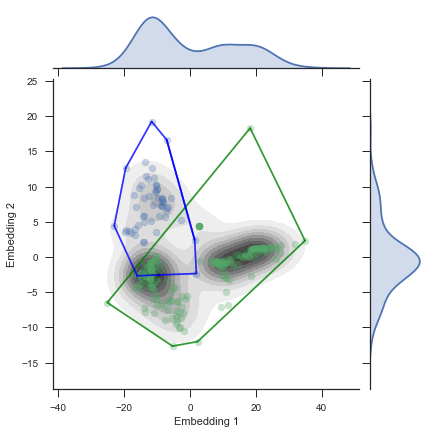

In [55]:
from scipy.spatial import ConvexHull, convex_hull_plot_2d
points1 = np.array(iso[:, experiment_idx_labels]).T   # 30 random points in 2-D
hull1 = ConvexHull(points1)

points0 = np.array(iso[:, model_index_labels]).T   # 30 random points in 2-D
hull0 = ConvexHull(points0)

set_style()    
ax = sns.jointplot(x=iso[0,:], y=iso[1,:],kind="kde",cmap='Greys')
#ax.axis.set(xlabel='common xlabel', ylabel='common ylabel', title='some title')

#ax.set(xlabel='Embedding 1', ylabel='Embedding 2', title='TSNE Dim Reduction')

cmaps = ['Blues','Purples']#,'Oranges']
#for i in range(clusters):
#x,y = iso[0,experiment_idx_labels],iso[1,experiment_idx_labels]
cola = cmaps.pop()
ax.ax_joint.scatter(points0[:,0],points0[:,1], cmap='b',label = 'Experiment',alpha=0.3)#,legend='brief')
colb = cmaps.pop()

ax.ax_joint.scatter(points1[:,0],points1[:,1], cmap='r',label = 'Model',alpha=0.3)#,legend='brief')



for simplex in hull1.simplices:
    ax.ax_joint.plot(points1[simplex, 0], points1[simplex, 1], 'g-',alpha=0.8,label='brief')
    #ax = sns.lineplot(data=wide_df["a"], color="coral", label="line")
    

for simplex in hull0.simplices:
    ax.ax_joint.plot(points0[simplex, 0], points0[simplex, 1], 'b-',alpha=0.8) 
    #plotly1.append((points0[simplex, 0],points0[simplex, 1]))

#We could also have directly used the vertices of the hull, which for 2-D are guaranteed to be in counterclockwise order:
#ax.ax_joint.legend_.remove()

#ax.plot_joint(plt.scatter, c="b", s=0.1, marker="o")
ax.ax_joint.collections[0].set_alpha(0)
ax.ax_joint.legend_.remove()
ax.ax_joint.set(xlabel='Embedding 1', ylabel='Embedding 2')#, title='TSNE Dim Reduction')
ax.ax_joint.plot(points0[simplex, 0], points0[simplex, 1], 'b-',alpha=0.8,label='Experiment')  

#ax.ax_joint.plot(points1[simplex, 0], points1[simplex, 1], 'g-',alpha=0.8,label='Models')     


plt.legend()
plt.show()



In [56]:
#ax.set_axis_labels(" Embedding 1")
#ax.x.set_axis_labels(" Embedding 1")
#ax.ax_joint.set(xlabel='Embedding 1', ylabel='Embedding 2', title='TSNE Dim Reduction')

In [57]:

import quantities as qt

units = qt.ms

spike_shape = {
    "initburst_sahp_vb_1.5x": qt.mV,
    "peak_t_1.5x": units,
    "peak_t_3.0x": units,
    "peak_time_3.0x": units,
    "sag_ratio1_3.0x": qt.mV / qt.mV,
    "steady_state_hyper_1.5x": qt.mV,
    "steady_state_voltage_stimend_1.5x": qt.mV,
    "fast_trough_t_1.5x": qt.ms,
    "fast_trough_t_3.0x": qt.ms,
    "upstroke_t_1.5x": qt.ms,
    "upstroke_t_3.0x": qt.ms,
    "voltage_after_stim_3.0x": qt.mV,
    "voltage_after_stim_1.5x": qt.mV,
    "steady_state_voltage_1.5x": qt.mV,
    "threshold_t_1.5x": units,
    "threshold_t_3.0x": units,
}

spike_time = {
    "AP2DelaySDTest_1.5x": qt.second,
    "AP2DelaySDTest_3.0x": qt.second,
    "AP_rise_time_1.5x": units,
    "AP_rise_time_3.0x": units,
    "ISIBurstMeanChangeTest_3.0x": units,
    "ISICVTest_3.0x": units,
    "ISI_log_slope_skip_3.0x": units,
    "adaptation_index2_3.0x": qt.mV,
}


accomodation = {
    "AccommodationRateMeanAtSSTest_3.0x": "spikes/second",
    "AccommodationRateToSSTest_3.0x": "spikes/second",
    "adaptation_index2_3.0x": "spikes/second",
}

rate = {
    "Spikecount_stimint_1.5x": "spikes/Second",
    "Spikecount_stimint_3.0x": "spikes/Second",
}
units = qt.MOhm 
resistance= {'input_resistance':units,
            'InputResistanceTest_1.5x':units,
            'InputResistanceTest_3.0x':units ,
            'ohmic_input_resistance_1.5x':units , 
            'ohmic_input_resistance_3.0x':units ,
            }    



shape_index = { 'AP_fall_indices_1.5x':qt.dimensionless,
       'AP_fall_indices_3.0x':qt.dimensionless, 
       'AP_rise_indices_1.5x':qt.dimensionless, 'AP_end_indices_3.0x':qt.dimensionless,
       'fast_trough_index_1.5x':qt.dimensionless, 'fast_trough_index_3.0x':qt.dimensionless,
       'min_AHP_indices_1.5x':qt.dimensionless, 'min_AHP_indices_3.0x':qt.dimensionless,        
       'peak_index_1.5x':qt.dimensionless, 
       'peak_index_3.0x':qt.dimensionless, 
       'peak_indices_1.5x':qt.dimensionless,
       'peak_indices_3.0x':qt.dimensionless,
       'threshold_index_1.5x':qt.dimensionless, 
       'threshold_index_3.0x':qt.dimensionless, 
       'upstroke_index_1.5x':qt.dimensionless, 
       'upstroke_index_3.0x':qt.dimensionless }
        
units = qt.ms 

other_two = { 'AP1RateOfChangePeakToTroughTest_3.0x':units,  
              'APlast_width_1.5x':units}

all_units = {}
all_units.update(shape_index)
all_units.update(other_two)

all_units.update(resistance)
all_units.update(rate)
all_units.update(accomodation)
all_units.update(spike_time)
all_units.update(spike_shape)


#More Features with high agreement between models and data

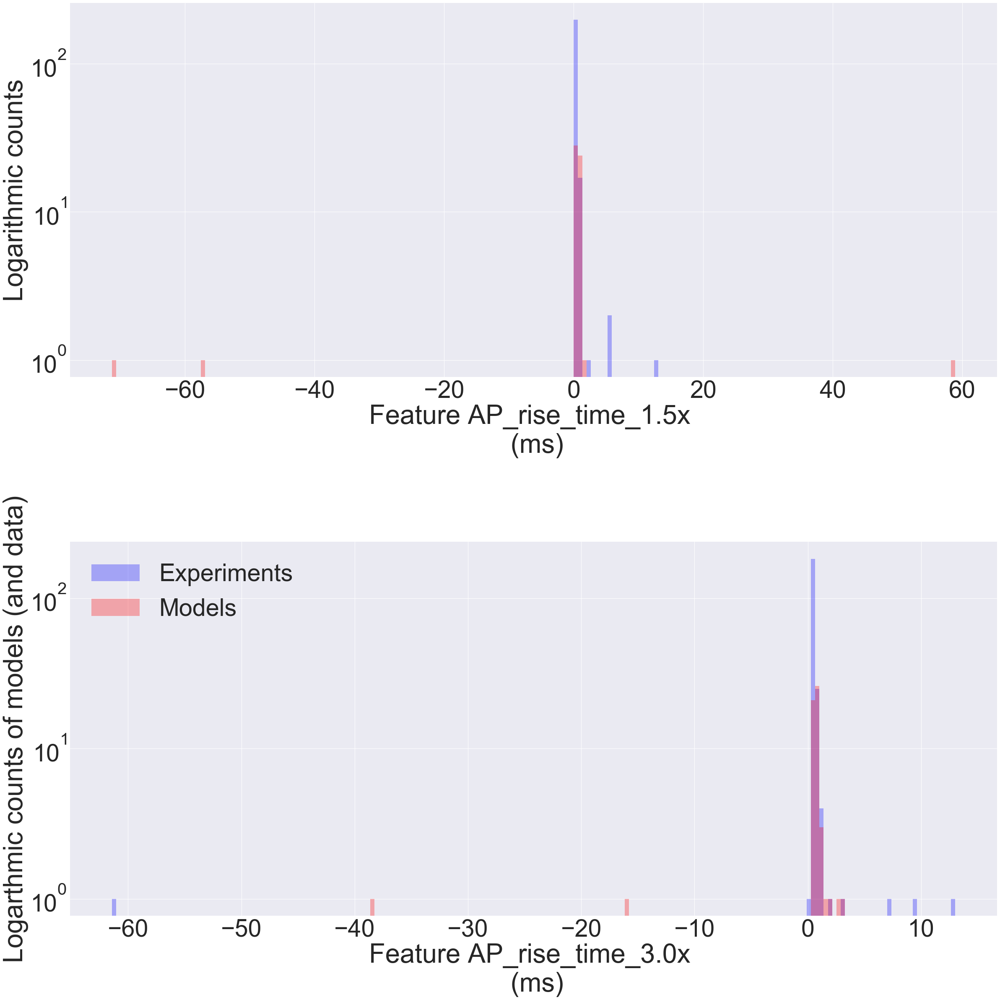

In [58]:
#df_models['AP_rise_time_1.5x'].hist(bins = np.linspace(0, 0.1, 20))
#df_experiment['AP_rise_time_1.5x'].hist(bins = np.linspace(0, 0.1, 20))

#df['AP_rise_time_3.0x']
sns.set(font_scale=1.15 * 5)

fig, axes = plt.subplots(2, 1, figsize=(35, 35))

minn = unscaled.loc[:, 'AP_rise_time_1.5x'].min()
maxx = unscaled.loc[:, 'AP_rise_time_1.5x'].max()
unscaled.loc[experiment_idx_labels, 'AP_rise_time_1.5x'].hist(ax=axes[0],alpha=0.3, bins=np.linspace(minn, maxx, 200), color="b", label="Experiments")
axes[0].semilogy()
unscaled.loc[model_index_labels, 'AP_rise_time_1.5x'].hist(ax=axes[0],alpha=0.3, bins=np.linspace(minn, maxx, 200), color="r", label="Models")
axes[0].semilogy()
feature = 'AP_rise_time_1.5x'
try:
    units = all_units[feature]
    if type(units) is not type(str()):
        units = units.symbol
except:
    units = "anything"
axes[0].set_xlabel(
    "Feature {0} \n ({1})".format(feature, units)
)

axes[0].set_ylabel(
    "Logarithmic counts"
)
feature = 'AP_rise_time_3.0x'
minn = unscaled.loc[:, 'AP_rise_time_3.0x'].min()
maxx = unscaled.loc[:, 'AP_rise_time_3.0x'].max()
unscaled.loc[experiment_idx_labels, 'AP_rise_time_3.0x'].hist(ax=axes[1],alpha=0.3, bins=np.linspace(minn, maxx, 200), color="b", label="Experiments")
#unscaled.loc[experiment_idx_labels, 'AP_rise_time_3.0x'].plot.kde(ax=axes[1], secondary_y=True)
axes[1].semilogy()

unscaled.loc[model_index_labels, 'AP_rise_time_3.0x'].hist(ax=axes[1],alpha=0.3, bins=np.linspace(minn, maxx, 200), color="r", label="Models")
#unscaled.loc[experiment_idx_labels, 'AP_rise_time_3.0x'].plot.kde(ax=axes[1], secondary_y=True)
try:
    units = all_units[feature]
    if type(units) is not type(str()):
        units = units.symbol
except:
    units = "anything"
axes[1].set_xlabel(
    "Feature {0} \n ({1})".format(feature, units)
)  # +str("_bandwidth_kernel"+str(bw)))
axes[1].set_ylabel("Logarthmic counts of models (and data)")  # feature.replace('_', '\n'))
axes[1].semilogy()
display(Markdown("#More Features with high agreement between models and data"))
plt.tight_layout()
plt.legend()


In [59]:
feature_agree;

AP_rise_time_1.5x


cohen score is : D = 0.58 AP_fall_indices_1.5x

cohen score is : D = 0.19 AP_rise_indices_1.5x

cohen score is : D = -0.07 AP_rise_time_3.0x

cohen score is : D = -0.17 APlast_width_1.5x

cohen score is : D = -0.46 AccommodationRateToSSTest_3.0x

cohen score is : D = -0.33 ISIBurstMeanChangeTest_3.0x

# Features with high agreement between models and data

<Figure size 432x288 with 0 Axes>

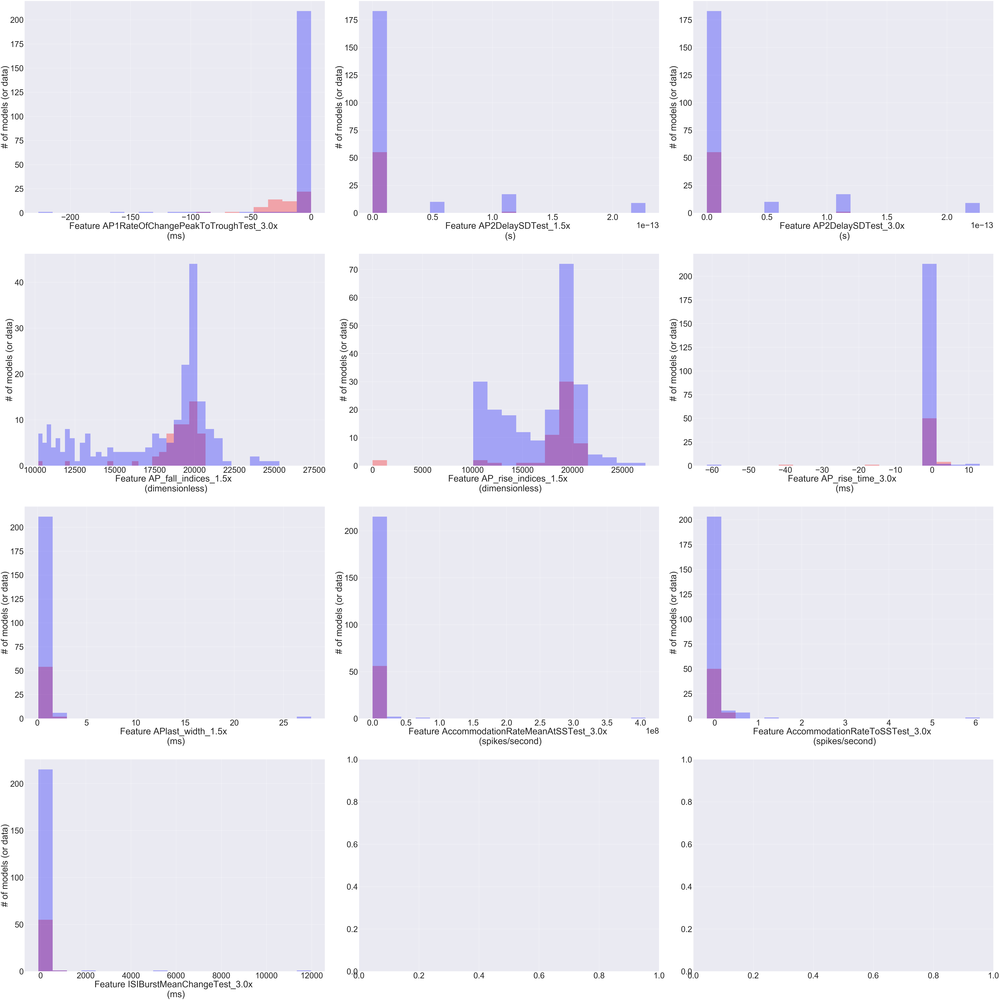

In [60]:

feature_agree = list(feature_agree)
for i, feature in enumerate(feature_agree):  # .items()):
    
    if str('AP_rise_time_') in str(feature):
        feature_agree.pop(i)
        print(feature)
#()        
sns.set(font_scale=1.15 * 5)

n_cols = 3
n_rows = int(len(feature_agree[0:10]) / 3) + 1
# n_rows = 2# n_rows
plt.clf()
fig, axes = plt.subplots(n_rows, n_cols, figsize=(100, 100))
        
for i, feature in enumerate(feature_agree[0:10]):  # .items()):

    #if str('AP_rise_time_') not in str(feature):
        
        
    #seriesm = unscaled.loc[model_index_labels, feature]
    #model  = seriesm[seriesm!=0]  
    #unscaled.loc[model_index_labels, feature] = model
    #seriese = unscaled.loc[experiment_idx_labels, feature]
    #experiment  = seriese[seriese!=0]  
    #unscaled.loc[experiment_idx_labels, feature] = experiment
    ax = axes.flat[i]
    n = unscaled.loc[model_index_labels, feature].notnull().sum()

    minn = unscaled.loc[:, feature].min()
    maxx = unscaled.loc[:, feature].max()
    #range_ = maxx - minn
    #minn -= range_ * 0.1
    #maxx += range_ * 0.1

    if minn > 0:
        log_bins = True
    else:
        log_bins = False

    if log_bins:
        assert minn > 0, "All data must be positive to do a log scale"
        bins = np.logspace(np.log10(minn), np.log10(maxx), 40)
    else:
        bins = np.linspace(minn, maxx, 20)
    if str(feature) in str('APlast_width_1.5x'):
        bins = np.linspace(minn, maxx, 20)
    '''
    if feature == "APlast_width_1.5x":
        bins = np.linspace(0, 0.25, 100)

        unscaled.loc[model_index_labels, feature].hist(
            ax=ax, alpha=0.3, bins=bins, color="r", label="Models"
        )
        unscaled.loc[experiment_idx_labels, feature].hist(
            ax=ax, alpha=0.3, bins=bins, color="b", label="Experiments"
        )
    '''
    #else:
    unscaled.loc[model_index_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="r", label="Models"
    )
    unscaled.loc[experiment_idx_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="b", label="Experiments"
    )
    try:
        units = all_units[feature]
        if type(units) is not type(str()):
            units = units.symbol
    except:
        units = "ratio"
    ax.set_xlabel(
        "Feature {0} \n ({1})".format(feature, units)
    )  # +str("_bandwidth_kernel"+str(bw)))
    ax.set_ylabel("# of models (or data)")  # feature.replace('_', '\n'))
    observation = {
        "mean": np.mean(df.loc[experiment_idx_labels, feature]),
        "std": np.std(df.loc[model_index_labels, feature]),
    }
    prediction = {
        "mean": np.mean(df.loc[model_index_labels, feature]),
        "std": np.std(df.loc[model_index_labels, feature]),
    }
    score = CohenDScore.compute(observation, prediction)
    if np.abs(float(score.raw)) < 0.65:
        display(Markdown("cohen score is : " + str(score) + str(" ") + str(feature)))

    #    print("agreement between model and data is bad:")
    #    print("feature: ", feature, " score: ", score)

from IPython.display import display, Markdown, Latex

display(Markdown("# Features with high agreement between models and data"))
plt.tight_layout()
plt.legend()

# plt.title('Relative Time Array Indexs')
fig.savefig("images/spike_shape_index.png", format="png")  # , dpi=600)

# Disagreement

In [61]:
#sns.set(font_scale=1.15 * 5)
sns.set(font_scale=2 * 10)

log_bins = False

n_cols = 3
n_rows = int(len(feature_variance[0:10]) / 3) + 1
plt.clf()
fig, axes = plt.subplots(n_cols, n_rows, figsize=(250, 220))

#fig, axes = plt.subplots(n_rows, n_cols, figsize=(55, 45))
for i, feature in enumerate(feature_variance[0:10]):  # .items()):
    ax = axes.flat[i]
    n = unscaled.loc[model_index_labels, feature].notnull().sum()
    index_max = unscaled.loc[model_index_labels, feature].idxmax()
    index_min = unscaled.loc[model_index_labels, feature].idxmin()
    if str("ISI") in str(feature):
        print(unscaled.loc[index_max,feature],index_max)
        #print(unscaled.loc[index_max,feature],index_min)

        print(np.max(unscaled.loc[:, feature]))
    minn = unscaled.loc[:, feature].min()
    maxx = unscaled.loc[:, feature].max()
    range_ = maxx - minn
    minn -= range_ * 0.1
    maxx += range_ * 0.1
    if log_bins:
        assert minn > 0, "All data must be positive to do a log scale"
        bins = np.logspace(np.log10(minn), np.log10(maxx), 40)
    else:
        bins = np.linspace(minn, maxx, 50)

    unscaled.loc[model_index_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="r", label="Models"
    )
    unscaled.loc[experiment_idx_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="b", label="Data"
    )
    # sns.kdeplot(np.abs(df.loc[model_index_labels, 'input_resistance']), color='r', ax=ax,label='Models', cut=0)
    # sns.kdeplot(np.abs(df.loc[experiment_idx_labels, 'input_resistance']), color='b', ax=ax,label='Experimental Data', cut=0)
    units = all_units[feature]
    if type(units) is not type(str()):
        try:
            units = units.units.symbol
        except:
            units = "ratio"
    ax.set_xlabel(
        "Feature {0} \n ({1})".format(feature, units)
    )  # +str("_bandwidth_kernel"+str(bw)))
    ax.set_ylabel("# of models (or data)")  # feature.replace('_', '\n'))
    ax.legend()
    observation = {
        "mean": np.mean(unscaled.loc[experiment_idx_labels, feature]),
        "std": np.std(unscaled.loc[model_index_labels, feature]),
    }
    prediction = {
        "mean": np.mean(unscaled.loc[model_index_labels, feature]),
        "std": np.std(unscaled.loc[model_index_labels, feature]),
    }
    score = CohenDScore.compute(observation, prediction)
    display(Markdown("cohen score is : "+str(feature)+str(score)))
    # score = CohenDScore.compute(observation, prediction)
    # if np.abs(float(score.raw)) > 0.65:
    #    print("agreement between model and data is bad:")
    #    print("feature: ", feature, " score: ", score)
display(
    Markdown(
        "# Features with where models and data disagree, good candidates for optimisation"
    )
)

plt.tight_layout()
# plt.title('Relative Time Array Indexs')
fig.savefig("images/spike_shape_index.png", format="png")  # , dpi=600)

cohen score is : sag_ratio1_3.0xD = 0.87

cohen score is : AP1RateOfChangePeakToTroughTest_3.0xD = -0.72

cohen score is : steady_state_hyper_1.5xD = -1.17

cohen score is : steady_state_voltage_stimend_1.5xD = -1.15

cohen score is : voltage_after_stim_1.5xD = -1.17

cohen score is : voltage_after_stim_3.0xD = -0.76

cohen score is : AccommodationRateToSSTest_3.0xD = -0.46

cohen score is : steady_state_voltage_1.5xD = -1.17

cohen score is : peak_index_1.5xD = -0.47

0.466339197746142 NMLCL001506
2.2116448203258825


cohen score is : ISI_log_slope_skip_3.0xD = -0.71

# Features with where models and data disagree, good candidates for optimisation

<Figure size 432x288 with 0 Axes>

In [62]:
from IPython.display import display, Markdown, Latex

display(Markdown("# Least Agreement"))
display(Markdown("# Variance explained"))

tl = pd.DataFrame(total_list[0:10])
display(tl)
display(Markdown("Feature extraction suite membership: "))
for k in total_list[0:10].index:
    try:
        display(Markdown(k + " belongs to: " + membership[k]))
    except:
        display(Markdown(k + " belongs to Druckman"))

# Least Agreement

# Variance explained

,0
sag_ratio1_3.0x,0.190
AP1RateOfChangePeakToTroughTest_3.0x,0.129
steady_state_hyper_1.5x,0.090
steady_state_voltage_stimend_1.5x,0.089
voltage_after_stim_1.5x,0.079
voltage_after_stim_3.0x,0.051
AccommodationRateToSSTest_3.0x,0.051
steady_state_voltage_1.5x,0.049
peak_index_1.5x,0.031
ISI_log_slope_skip_3.0x,0.025


Feature extraction suite membership: 

sag_ratio1_3.0x belongs to: efel

AP1RateOfChangePeakToTroughTest_3.0x belongs to Druckman

steady_state_hyper_1.5x belongs to: efel

steady_state_voltage_stimend_1.5x belongs to: efel

voltage_after_stim_1.5x belongs to: efel

voltage_after_stim_3.0x belongs to: efel

AccommodationRateToSSTest_3.0x belongs to Druckman

steady_state_voltage_1.5x belongs to: efel

peak_index_1.5x belongs to: allen

ISI_log_slope_skip_3.0x belongs to: efel

In [63]:
from IPython.display import display, Markdown, Latex

display(Markdown("# Best Agreement"))
display(Markdown("# Least Variance explained"))

tl = pd.DataFrame(total_list[-11:-1])
display(tl)
# for k in total_list[0:10].index:
display(Markdown("Feature extraction suite membership: "))

for k in tl.index:
    try:
        display(Markdown(k + " belongs to: " + membership[k]))
    except:
        display(Markdown(k + " belongs to Druckman"))

# Best Agreement

# Least Variance explained

,0
threshold_t_1.5x,2.052e-03
AP_rise_indices_1.5x,2.037e-03
upstroke_t_3.0x,1.704e-03
min_AHP_indices_3.0x,1.437e-03
upstroke_t_1.5x,8.622e-04
AP_fall_indices_1.5x,8.406e-04
peak_time_3.0x,7.867e-04
APlast_width_1.5x,1.866e-04
initburst_sahp_vb_1.5x,0.000e+00
AP2DelaySDTest_3.0x,0.000e+00


Feature extraction suite membership: 

threshold_t_1.5x belongs to: allen

AP_rise_indices_1.5x belongs to: efel

upstroke_t_3.0x belongs to: allen

min_AHP_indices_3.0x belongs to: efel

upstroke_t_1.5x belongs to: allen

AP_fall_indices_1.5x belongs to: efel

peak_time_3.0x belongs to: efel

APlast_width_1.5x belongs to: efel

initburst_sahp_vb_1.5x belongs to: efel

AP2DelaySDTest_3.0x belongs to Druckman

# Everything Exhaustively

In [64]:
#%%capture
unscaled_columns = list(copy.copy(unscaled.columns))
sns.set(font_scale=2 * 10)
log_bins = False

n_cols = 2
quater = int(len(unscaled.columns) / 4)

n_rows = int(quater / n_cols + 1)
plt.clf()
fig, axes = plt.subplots(n_rows, n_cols, figsize=(250, 250))
cnt = 0
for i, feature in enumerate(unscaled_columns[0:quater]):
    ax = axes.flat[i]

    n = unscaled.loc[model_index_labels, feature].notnull().sum()
    index_max = unscaled.loc[model_index_labels, feature].idxmax()
    index_min = unscaled.loc[model_index_labels, feature].idxmin()
    # print(unscaled.loc[index_max,feature],index_min)

    # print(np.sum(unscaled.loc[:, feature]))
    minn = unscaled.loc[:, feature].min()
    maxx = unscaled.loc[:, feature].max()
    #range_ = maxx - minn
    #minn -= range_ * 0.1
    
    #maxx += range_ * 0.1
    if minn > 0:
        log_bins = True
    else:
        log_bins = False

    if log_bins:
        assert minn > 0, "All data must be positive to do a log scale"
        bins = np.logspace(np.log10(minn), np.log10(maxx), 40)
    else:
        bins = np.linspace(minn, maxx, 100)

    unscaled.loc[model_index_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="r", label="Models"
    )
    unscaled.loc[experiment_idx_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="b", label="Data"
    )
    try:
        units = all_units[feature]
    except:
        units = 'ratio'
    if type(units) is not type(str()):
        try:
            units = units.units.symbol
        except:
            units = "ratio"
    ax.set_xlabel(
        "Feature {0} \n ({1})".format(feature, units)
    )  # +str("_bandwidth_kernel"+str(bw)))
plt.tight_layout()
plt.show()


<Figure size 432x288 with 0 Axes>

In [65]:
# n_rows = quater / n_cols + 1
plt.clf()
fig, axes = plt.subplots(n_rows, n_cols, figsize=(250, 250))


for i, feature in enumerate(unscaled_columns[quater : quater + quater]):  # .items()):

    ax = axes.flat[i]

    n = unscaled.loc[model_index_labels, feature].notnull().sum()
    index_max = unscaled.loc[model_index_labels, feature].idxmax()
    index_min = unscaled.loc[model_index_labels, feature].idxmin()
    # print(unscaled.loc[index_max,feature],index_min)

    # print(np.sum(unscaled.loc[:, feature]))
    minn = unscaled.loc[:, feature].min()
    if minn > 0:
        log_bins = True
    else:
        log_bins = False
    maxx = unscaled.loc[:, feature].max()
    #range_ = maxx - minn
    #minn -= range_ * 0.1
    #maxx += range_ * 0.1
    if log_bins:
        assert minn > 0, "All data must be positive to do a log scale"
        bins = np.logspace(np.log10(minn), np.log10(maxx), 40)
    else:
        bins = np.linspace(minn, maxx, 100)

    unscaled.loc[model_index_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="r", label="Models"
    )
    unscaled.loc[experiment_idx_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="b", label="Data"
    )
    try:
        units = all_units[feature]
    except:
        units = None
    if type(units) is not type(str()):
        try:
            units = units.units.symbol
        except:
            units = "nothing"
    ax.set_xlabel(
        "Feature {0} \n ({1})".format(feature, units)
    )  # +str("_bandwidth_kernel"+str(bw)))
plt.tight_layout()
plt.show()
# n_cols = 2


<Figure size 432x288 with 0 Axes>

In [66]:
plt.clf()
fig, axes = plt.subplots(n_rows, n_cols, figsize=(250, 250))

for i, feature in enumerate(unscaled_columns[quater + quater : quater + quater + quater]):  # .items()):

    ax = axes.flat[i]

    n = unscaled.loc[model_index_labels, feature].notnull().sum()
    index_max = unscaled.loc[model_index_labels, feature].idxmax()
    index_min = unscaled.loc[model_index_labels, feature].idxmin()
    # print(unscaled.loc[index_max,feature],index_min)

    # print(np.sum(unscaled.loc[:, feature]))
    minn = unscaled.loc[:, feature].min()
    maxx = unscaled.loc[:, feature].max()
    range_ = maxx - minn
    #minn -= range_ * 0.1
    #maxx += range_ * 0.1
    if minn > 0:
        log_bins = True
    else:
        log_bins = False

    if log_bins:
        assert minn > 0, "All data must be positive to do a log scale"
        bins = np.logspace(np.log10(minn), np.log10(maxx), 40)
    else:
        bins = np.linspace(minn, maxx, 100)

    unscaled.loc[model_index_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="r", label="Models"
    )
    unscaled.loc[experiment_idx_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="b", label="Data"
    )
    try:
        units = all_units[feature]
    except:
        units = None
    if type(units) is not type(str()):
        try:
            units = units.units.symbol
        except:
            units = "nothing"
    ax.set_xlabel(
        "Feature {0} \n ({1})".format(feature, units)
    )  # +str("_bandwidth_kernel"+str(bw)))
plt.tight_layout()
plt.show()



<Figure size 432x288 with 0 Axes>

In [67]:
plt.clf()
fig, axes = plt.subplots(n_rows, n_cols, figsize=(250, 250))

for i, feature in enumerate(unscaled_columns[3 * quater : 4 * quater]):  # .items()):

    ax = axes.flat[i]

    n = unscaled.loc[model_index_labels, feature].notnull().sum()
    index_max = unscaled.loc[model_index_labels, feature].idxmax()
    index_min = unscaled.loc[model_index_labels, feature].idxmin()
    # print(unscaled.loc[index_max,feature],index_min)

    # print(np.sum(unscaled.loc[:, feature]))
    minn = unscaled.loc[:, feature].min()
    maxx = unscaled.loc[:, feature].max()
    range_ = maxx - minn
    #minn -= range_ * 0.1
    maxx += range_ * 0.1
    if log_bins:
        assert minn > 0, "All data must be positive to do a log scale"
        bins = np.logspace(np.log10(minn), np.log10(maxx), 40)
    else:
        bins = np.linspace(minn, maxx, 100)
    bins = np.linspace(minn, maxx, 100)
    unscaled.loc[model_index_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="r", label="Models"
    )
    unscaled.loc[experiment_idx_labels, feature].hist(
        ax=ax, alpha=0.3, bins=bins, color="b", label="Data"
    )
    try:
        units = all_units[feature]
    except:
        units = None
    if type(units) is not type(str()):
        try:
            units = units.units.symbol
        except:
            units = "ratio"
    ax.set_xlabel(
        "Feature {0} \n ({1})".format(feature, units)
    )  # +str("_bandwidth_kernel"+str(bw)))
plt.tight_layout()
plt.show()

<Figure size 432x288 with 0 Axes>

Two good experiments to optimize against, as it seems closer to models.
    **"Layer 4 aspiny 313862167",**
    **"Layer 4 spiny 479728896",**


In [68]:
pubs_df.head(10)


,Cell Name,Publication,Cell ID
NMLCL001430,Primary visual area layer 6a spiny 466632464,Systematic generation of biophysically detaile...,NMLCL001430
NMLCL001433,Primary visual area layer 4 spiny 469798159,Systematic generation of biophysically detaile...,NMLCL001433
NMLCL001438,Lateral visual area layer 4 aspiny 313862167,Systematic generation of biophysically detaile...,NMLCL001438
NMLCL001439,posteromedial visual area layer 4 spiny 485912047,Systematic generation of biophysically detaile...,NMLCL001439
NMLCL001441,Primary visual area layer 5 spiny 471758398,Systematic generation of biophysically detaile...,NMLCL001441
NMLCL001442,Primary visual area layer 5 aspiny 466664172,Systematic generation of biophysically detaile...,NMLCL001442
NMLCL001444,Primary visual area layer 4 spiny 476087653,Systematic generation of biophysically detaile...,NMLCL001444
NMLCL001445,Primary visual area layer 2/3 aspiny 333604946,Systematic generation of biophysically detaile...,NMLCL001445
NMLCL001447,Primary visual area layer 5 aspiny 478110866,Systematic generation of biophysically detaile...,NMLCL001447
NMLCL001449,Primary visual area layer 5 spiny 480116737,Systematic generation of biophysically detaile...,NMLCL001449


In [69]:
pubs_df.tail(10)

,Cell Name,Publication,Cell ID
NMLCL001492,Primary visual area layer 5 spiny 475744706,Systematic generation of biophysically detaile...,NMLCL001492
NMLCL001495,Primary visual area layer 5 spiny 478888052,Systematic generation of biophysically detaile...,NMLCL001495
NMLCL001500,posteromedial visual area layer 4 spiny 321906005,Systematic generation of biophysically detaile...,NMLCL001500
NMLCL001504,Primary visual area layer 4 spiny 479704527,Systematic generation of biophysically detaile...,NMLCL001504
NMLCL001506,Primary visual area layer 6a spiny 471819401,Systematic generation of biophysically detaile...,NMLCL001506
NMLCL001521,Primary visual area layer 4 spiny 422738880,Systematic generation of biophysically detaile...,NMLCL001521
NMLCL001526,Primary visual area layer 4 spiny 397351623,Systematic generation of biophysically detaile...,NMLCL001526
NMLCL001533,Primary visual area layer 4 spiny 320668879,Systematic generation of biophysically detaile...,NMLCL001533
NMLCL001535,Primary visual area layer 2/3 spiny 318808427,Systematic generation of biophysically detaile...,NMLCL001535
NMLCL001541,Primary visual area layer 2/3 spiny 382982932,Systematic generation of biophysically detaile...,NMLCL001541
